# F1 teammate head-to-head

In [ ]:
# | code-fold: true

import warnings
import logging
from itables import show

import arviz as az
import numpy as np
import pandas as pd
import pymc as pm
import fastf1
import seaborn as sns
from tqdm import tqdm
from datetime import datetime
from matplotlib import pyplot as plt

In [ ]:
# | code-fold: true
%matplotlib inline

warnings.filterwarnings("ignore", category=FutureWarning)

sns.set_theme()
sns.set_style(style="darkgrid", rc={"axes.facecolor": ".9", "grid.color": ".8"})
sns.set_palette(palette="deep")
sns_c = sns.color_palette(palette="deep")

plt.rcParams["figure.figsize"] = [10, 7]

az.style.use("arviz-docgrid")

My previous post looked at estimating the Fantasy GP points generated by each individual driver and team for the 2023 Formula 1 season, in order to inform team construction decisions and maximize points earned. We used a very simple zero-inflated negative binomial model to directly estimate the mean points per race a driver/team is likely to generate under the Fantasy GP ruleset. The results for the 2023 season, compared to the model estimate (which used data from the first 14 rounds):

Estimating points directly is straightforward but potentially noisy and inflexible. Noisy because many unmodeled factors can drastically influence the results - e.g. taking engine penalties, crashes, odd weather, all increase our uncertainty, and inflexible because we can't directly compare different point-generating aspects when making a decisions - e.g. Albon and Tsunoda earned a significant amount of points when racing against a weak teammate, but that won't necessarily stay true if they have to contend with a stronger one. A more granular approach - where qualifying results, finishing position, and performance against teammates are modeled directly, will likely be much more useful (and interesting overall).

This post will attempt to tackle the latter - head to head performance against teammates and other drivers. The goal is to model the likelihood of a given driver finishing ahead of any other driver, without taking actual finishing positions (and the magnitude of difference) into account.

To do so we'll use an uncentered version of the Bradley-Terry model[^1] [as described by Martin Ingram](https://martiningram.github.io/mcmc-comparison/) to first rank teammates against eachother, and eventually extend to a full ranking of all drivers in the dataset. We'll also extend the model to take the driver's skill on different track types into account, as well as try to model constructor advantage at the same time.

For each model, we'll use the same approach as before:
1. Pick priors and construct the model definition:
   Each parameter will follow the original model definition and prior values.
2. Sample and verify the prior predictive distribution:
   Here we are just making sure that the prior distribution could have plausibly generated the observed data and isn't weird or malformed.
3. Run inference and verify convergence and sampling efficiency:
   We'll sample each model with the default sampling paramters, except for `target_accept`, which will be bumped from 0.8 to 0.9. Then, we'll check the trace and energy plots, as well as effective sample size and `r_hat`, looking for the following conditions:
   - the chains should show good mixing - KDEs should overlap well and the trace plots should be patternless and noisy[^2]
   - marginal energy and transition energy should overlap well and BFMI should be above .3[^3]
   - bulk and tail ESS should be > 400 [^4]
   - `r_hat` should ideally be between 1 and 1.01[^5]
   - `mcse_{mean, sd}` should be low[^6]
7. Evaluate the posterior and predictive performance:
   We'll interpret the inferred ranking values and perform cross validation and model comparison [^7]

[^1]: Wikipedia has a decent overview: https://en.wikipedia.org/wiki/Bradley%E2%80%93Terry_model
    Some further reading: [Efficient Bayesian Inference for Generalized Bradley-Terry Models](https://arxiv.org/pdf/1011.1761.pdf),
    and [Francesco Bruzzesi's PyData Amsterdam 2023 talk on Bayesian ranking for tennis players](https://www.youtube.com/watch?v=z79fClXBOnM)

[^2]: see [this section in the PyMC documentation](https://www.pymc.io/projects/docs/en/stable/learn/core_notebooks/pymc_overview.html#model-checking)

[^3]: see [this section in the PyMC documentation](https://www.pymc.io/projects/docs/en/stable/learn/core_notebooks/pymc_overview.html#model-checking)

[^4]: see this section in [Bayesian Modeling and Computation in Python](https://bayesiancomputationbook.com/markdown/chp_02.html#effective-sample-size)

[^5]: see this section in [Bayesian Modeling and Computation in Python](https://bayesiancomputationbook.com/markdown/chp_02.html#potential-scale-reduction-factor-hat-r)

[^6]: see this section in [Bayesian Modeling and Computation in Python](https://bayesiancomputationbook.com/markdown/chp_02.html#monte-carlo-standard-error)

[^7]: see this section in [Bayesian Modeling and Computation in Python](https://bayesiancomputationbook.com/markdown/chp_02.html#cross-validation-and-loo)

:::{.callout-warning title="Disclaimer"}
I have a fairly limited knowledge of Bayesian statistics and modeling; this notebook shouldn’t be considered authoritative of prescriptive in any way. It is mostly a collection of notes, reflecting ongoing learning.
:::

## Data acquisition

We start by loading the data for the 2022 through 2024 seasons (turbo-hybrid ground effect era), using the excellent [FastF1](https://github.com/theOehrly/Fast-F1) package. For each round in a given season we load the grand prix and qualifying sessions, as well as lap timing data for the grand prix, in order to construct a dataframe holding the qualifying and finishing order, as well as fastest lap winner information:

In [ ]:
# | code-fold: true

SEASONS = [2022, 2023, 2024]

RENAME_MAP = {
    "Abbreviation": "driver",
    "TeamId": "constructor",
    "ClassifiedPosition": "classified_pos",
    "GridPosition": "grid_pos",
    "Points": "points",
    "Position": "finishing_pos",
    "Status": "status",
}

GP_COLS = [
    "Abbreviation",
    "TeamId",
    "Position",
    "ClassifiedPosition",
    "GridPosition",
    "Points",
    "Status",
]

QUALI_COLS = ["Abbreviation", "Position"]

GP_DATA_COLS = [
    "season",
    "round",
    "circuit",
    "driver",
    "constructor",
    "qualifying_pos",
    "grid_pos",
    "classified_pos",
    "finishing_pos",
    "points",
    "fastest_lap",
    "status",
]

In [ ]:
# | code-fold: false


def get_gp_data(season, gp):
    quali_session = fastf1.get_session(
        year=season, gp=gp.RoundNumber, identifier="Qualifying"
    )
    quali_session.load(telemetry=False, laps=False, weather=True)

    gp_session = fastf1.get_session(year=season, gp=gp.RoundNumber, identifier="Race")
    gp_session.load(telemetry=False, laps=True, weather=True)

    return (
        gp_session.results[GP_COLS]
        .rename(RENAME_MAP, axis=1)
        .join(
            quali_session.results[QUALI_COLS]
            .rename(RENAME_MAP, axis=1)
            .set_index("driver"),
            on="driver",
            rsuffix="_qualifying",
        )
        .rename({"finishing_pos_qualifying": "qualifying_pos"}, axis=1)
        .assign(
            fastest_lap=lambda df: df["driver"]
            == gp_session.laps.pick_fastest().Driver,
            circuit=gp.Location,
            round=gp.RoundNumber,
            season=season,
        )
    )[GP_DATA_COLS]


def get_season_data(season):
    schedule = fastf1.get_event_schedule(season, include_testing=False)
    gp_list = list(schedule[["RoundNumber", "Location", "EventDate"]].itertuples())

    season_data = []
    for gp in tqdm(gp_list):
        if gp.EventDate <= datetime.now():
            season_data.append(get_gp_data(season, gp))

    return pd.concat(season_data)


def get_seasons_data(seasons):
    return pd.concat([get_season_data(season) for season in seasons]).reset_index(
        drop=True
    )

In [ ]:
# | output: false
# | code-fold: false


logging.disable(logging.CRITICAL)

data_df = get_seasons_data(SEASONS)

logging.disable(logging.NOTSET)

100%|███████████████████████████████████████████████████████████████████████████████████████████████████████| 24/24 [00:04<00:00,  5.37it/s]


A couple of adjustments are necessary to make everything work nicely:
- for continuity, the Alpha Tauri and Alfa Romeo teams are retroactively renamed to match their current names (RB & Sauber)
- a classification row is added to the 2024 Melbourne Grand Prix for Logan Sargeant, who did not enter the race, as Williams didn't have a spare chassis after his teammate's crash in free practice

In [ ]:
# | code-fold: false

seasons_data_df = (
    pd.concat(
        [
            data_df.replace({"alphatauri": "rb", "alfa": "sauber"}),
            pd.DataFrame(
                [
                    [
                        2024,  # season
                        3,  # round
                        "Melbourne",  # circuit
                        "SAR",  # driver
                        "williams",  # constructor
                        20,  # qualifying_pos
                        20,  # grid_pos
                        "R",  # classified_pos
                        20,  # finishing_pos
                        0,  # points
                        False,  # fastest_lap
                        "Did not start",  # status
                    ]
                ],
                columns=data_df.columns,
            ),
        ]
    )
    .sort_values(["season", "round", "finishing_pos"])
    .reset_index(drop=True)
)

In [ ]:
# | code-fold: true
show(seasons_data_df, pageLength=20)

Next, we transform the classification dataframe into a teammate head to head performance dataframe, where the winner column holds the driver who won over their teammate at that particular race. In this case, we'll keep DNF results in the dataset:

In [ ]:
# | code-fold: false


def get_teammate_h2h(df, pivot_col="finishing_pos"):
    group_cols = ["season", "circuit", "constructor"]
    drivers = pd.CategoricalDtype(df["driver"].unique())

    return (
        df.groupby(group_cols, group_keys=False)
        .apply(
            lambda g: g.pivot(
                index=group_cols, columns=pivot_col, values="driver"
            ).set_axis(["winner", "loser"], axis=1)
        )
        .reset_index()
        .astype({"winner": drivers, "loser": drivers})
        .dropna()
    )

In [ ]:
# | code-fold: true

gp_teammate_h2h_df = get_teammate_h2h(seasons_data_df)
show(gp_teammate_h2h_df, caption="Teammate head-to-head", pageLength=10)

/tmp/ipykernel_14501/2622497366.py:10: DeprecationWarning: DataFrameGroupBy.apply operated on the grouping columns. This behavior is deprecated, and in a future version of pandas the grouping columns will be excluded from the operation. Either pass `include_groups=False` to exclude the groupings or explicitly select the grouping columns after groupby to silence this warning.
  .apply(


Finally, we get the index vectors for the winner/loser pairs, which will be the core input to the Bradley-Terry model - the observed data is simply a vector of 1s, with the same shape as the index, since the structure of the likelihood parameter already encodes the outcome of each contest:

In [ ]:
# | code-fold: false

drivers = gp_teammate_h2h_df["winner"].dtype.categories

team_h2h_winners_idx = gp_teammate_h2h_df["winner"].cat.codes
team_h2h_losers_idx = gp_teammate_h2h_df["loser"].cat.codes

observed = np.ones(team_h2h_winners_idx.shape)

## Teammate head-to-head

### Model definition

We start with the simplest case, a direct copy of the non-centered model[^1]:

[^1] As mentioned above, the implementation is essentially the same as the one from [Martin Ingram's post](https://martiningram.github.io/mcmc-comparison/) & [Francesco Bruzzesi](https://www.youtube.com/watch?v=z79fClXBOnM)

In [ ]:
# | code-fold: false

with pm.Model(coords={"driver": drivers}) as gp_teammate_h2h:
    σ_skill = pm.HalfNormal("σ_skill", sigma=1)
    μ_skill = pm.Normal("μ_skill", mu=0, sigma=1, dims="driver")
    skill = pm.Deterministic("skill", σ_skill * μ_skill, dims="driver")

    Δ_skill = skill[team_h2h_winners_idx] - skill[team_h2h_losers_idx]

    y = pm.Bernoulli("y", logit_p=Δ_skill, observed=observed)

### Prior predictive checks

We sample the prior predictive and plot it to verify that its shape makes sense (observed values are omitted as those are all wins):

In [ ]:
# | code-fold: false

with gp_teammate_h2h:
    gp_teammate_h2h_prior_idata = pm.sample_prior_predictive()

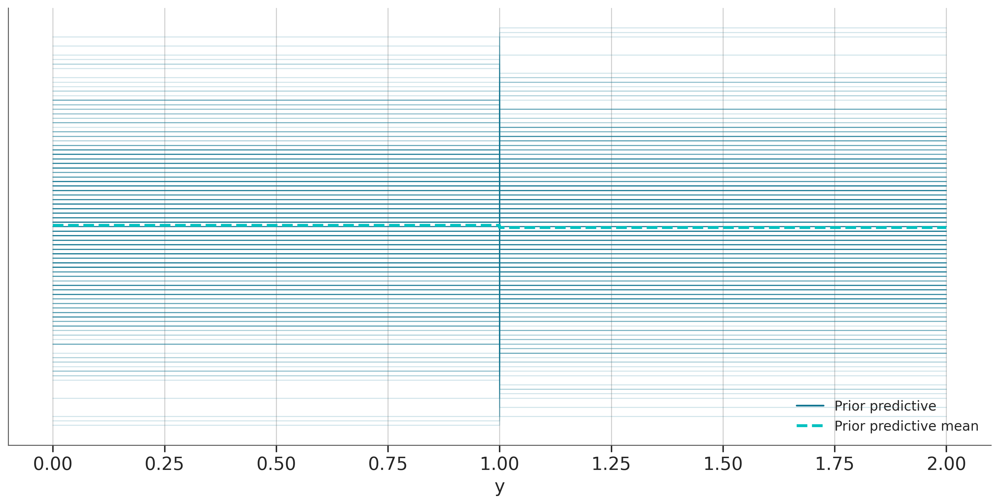

In [ ]:
# | label: fig-gp-teammate-h2h-prior-pred
# | fig-cap: "Prior predictive distribution of the base teammate head-to-head model."

az.plot_ppc(
    gp_teammate_h2h_prior_idata, group="prior", observed=False, figsize=(12, 6)
);

### Inference and diagnostics

The prior predictive looks reasonable, so we can proceed with sampling the model and posterior predictive:

In [ ]:
# | code-fold: false

with gp_teammate_h2h:
    gp_teammate_h2h_idata = pm.sample(
        target_accept=0.9, idata_kwargs={"log_likelihood": True}
    )
    pm.sample_posterior_predictive(gp_teammate_h2h_idata, extend_inferencedata=True)

First, as usual, we check the parameter traces - we want the KDEs of the chains (left) to overlap as much as possible, and for the trace (right) to look more or less like white noise:

/home/kiril/.local/lib/python3.11/site-packages/arviz/plots/traceplot.py:222: UserWarning: rcParams['plot.max_subplots'] (20) is smaller than the number of variables to plot (26), generating only 20 plots
  warnings.warn(


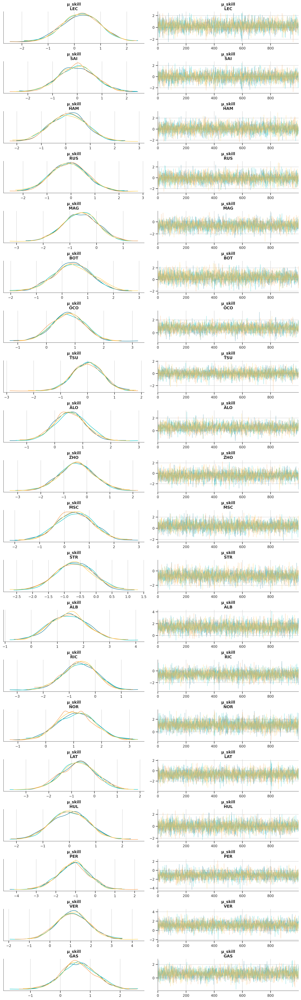

In [ ]:
# | label: fig-gp-teammate-h2h-trace
# | fig-cap: "Trace plots for the base teammate head-to-head model."

az.plot_trace(gp_teammate_h2h_idata, var_names=["μ_skill"], compact=False);

Traces seem reasonable. Next, we check the energy and BFMI plot:

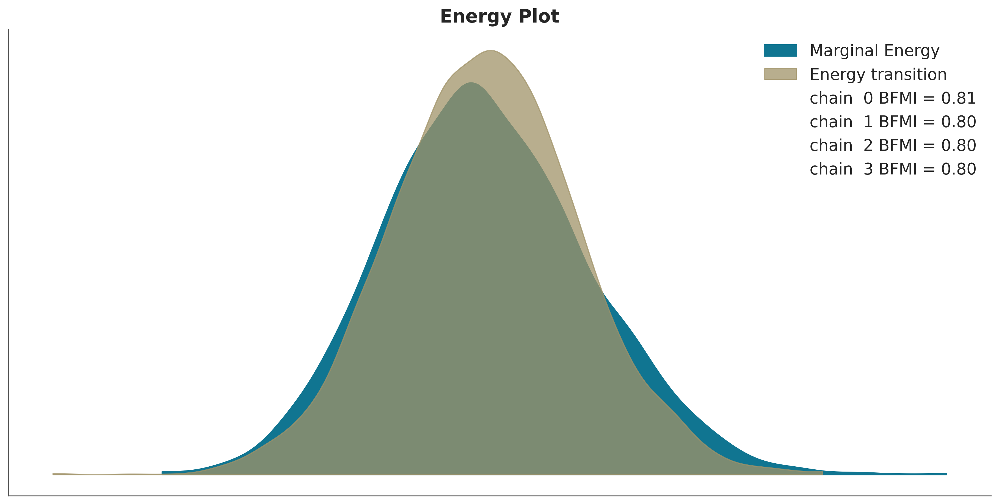

In [ ]:
# | label: fig-gp-teammate-h2h-energy
# | fig-cap: "Energy plot for the base teammate head-to-head model."

ax = az.plot_energy(gp_teammate_h2h_idata, figsize=(12, 6))
ax.set_title("Energy Plot");

Lastly, we look at the summary statistics - here we want to see that rhat is at around 1, not larger than 1.01 (higher rhat would mean significant inter-chain variance, indicating convergence issues), and ESS above 400 (below that and there wouldn't be enough information to accurately estimate rhat):

In [ ]:
# | code-fold: true

show(az.summary(gp_teammate_h2h_idata, var_names=["μ_skill"]), pageLength=50)

### Posterior predictive checks

The inference diagnostics indicate that the model has converged and that there were no issues during sampling. Now we can plot the poisterior predictive:

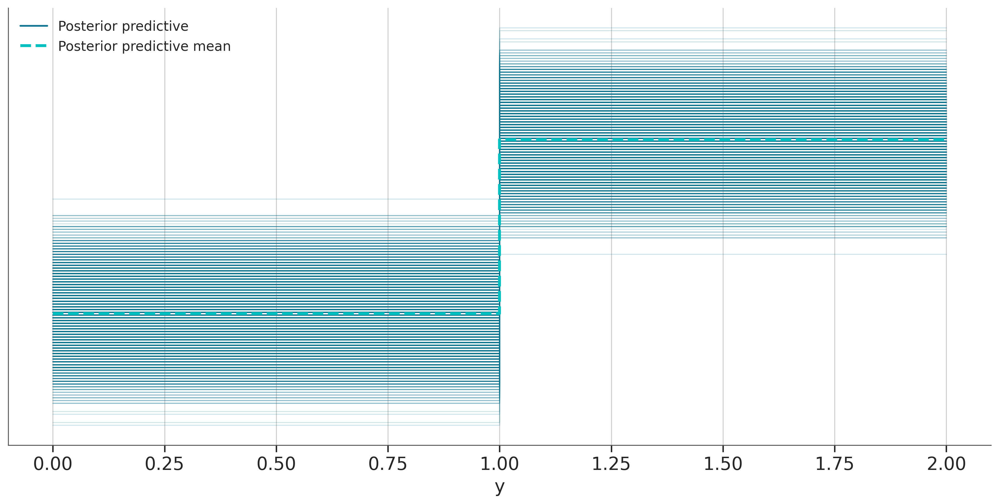

In [ ]:
# | label: fig-gp-teammate-h2h-posterior-pred
# | fig-cap: "Posterior predictive distribution for the base teammate head-to-head model"

az.plot_ppc(gp_teammate_h2h_idata, observed=False, figsize=(12, 6));

### Posterior evaluation

Finally, we can take a look at the resulting skill rating of each driver's performance against their teammate:

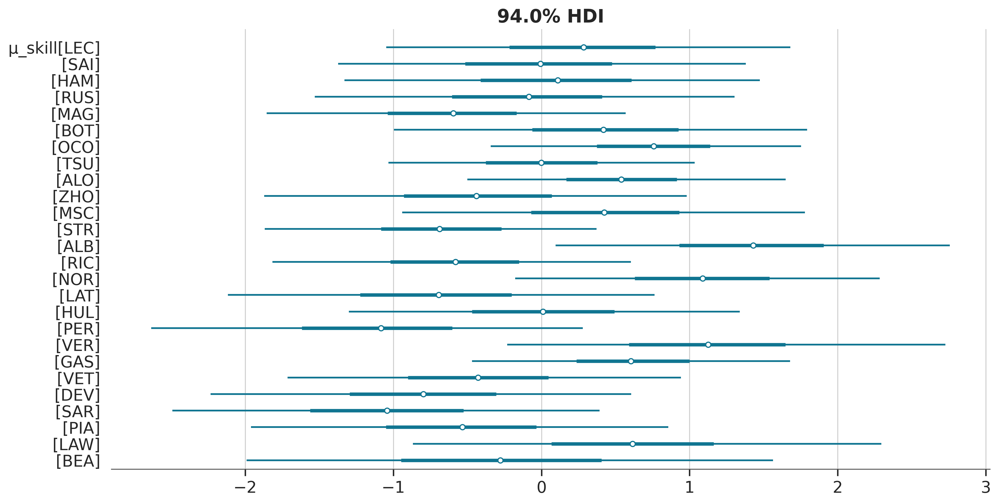

In [ ]:
# | label: fig-gp-teammate-h2h-posterior
# | fig-cap: "Posterior distributions of driver performance against their teammate."

az.plot_forest(
    gp_teammate_h2h_idata, var_names=["μ_skill"], combined=True, figsize=(12, 6)
);

The skill score can be interpreted as the probablility that the given driver will finish ahead of their teammate. 0 indicates an equal chance of the result going either way, the further into the positive direction we go, the more likely that driver is to beat their teammate, and vice versa. Note that this doesn't tell us anything about the magnitude, e.g. how many places ahead/behind, and it doesn't allow us to compare drivers across teams - for example, Perez is certainly better than Latifi, his score only indicates how dominant Verstappen has been as a teammate. Furthermore, some of the drivers in the ranking have had more than one teammate over the timespan, in which case their ability score can't be interpreted as a direct comparison to their current one.

One last thing we can look at is elpd_loo and whether there were any warnings generated by the diagnostic values during cross validation:

In [ ]:
# | code-fold: false

az.loo(gp_teammate_h2h_idata)

Computed from 4000 posterior samples and 470 observations log-likelihood matrix.

         Estimate       SE
elpd_loo  -299.22     7.08
p_loo       12.98        -
------

Pareto k diagnostic values:
                         Count   Pct.
(-Inf, 0.5]   (good)      470  100.0%
 (0.5, 0.7]   (ok)          0    0.0%
   (0.7, 1]   (bad)         0    0.0%
   (1, Inf)   (very bad)    0    0.0%

## Teammate head-to-head with track type

Next we'll look into whether the circuit type has any effect on the results. Formula 1 track types broadly fall into two categories - purpose built racing tracks like Silverstone and temporary street tracks like Monaco. Some drivers appear to be better at racing on one type compared to the other, so it might be worth investigating if track type improves our estimate of teammate head-to-head performance.

This requires some additional data. We merge a column indicating the circuit type to the dataframe and then prepare an index over it similar to the winners/losers index in order to track (yeah...) the new parameter:

In [ ]:
# | code-fold: false

circuit_type_df = pd.DataFrame({
    "circuit": [
        "Austin",
        "Baku",
        "Barcelona",
        "Budapest",
        "Imola",
        "Jeddah",
        "Las Vegas",
        "Le Castellet",
        "Lusail",
        "Marina Bay",
        "Melbourne",
        "Mexico City",
        "Miami",
        "Monaco",
        "Montréal",
        "Monza",
        "Sakhir",
        "Silverstone",
        "Spa-Francorchamps",
        "Spielberg",
        "Suzuka",
        "São Paulo",
        "Yas Island",
        "Zandvoort",
    ],
    "circuit_type": [
        "permanent",
        "street",
        "permanent",
        "permanent",
        "permanent",
        "street",
        "street",
        "permanent",
        "permanent",
        "street",
        "street",
        "street",
        "permanent",
        "street",
        "permanent",
        "permanent",
        "permanent",
        "permanent",
        "permanent",
        "permanent",
        "permanent",
        "permanent",
        "permanent",
        "permanent",
    ]
})

gp_teammate_h2h_df = gp_teammate_h2h_df.merge(
    circuit_type_df,
    on="circuit",
)

In [ ]:
# | code-fold: false

circuit_type_idx, circuit_types = pd.factorize(
    gp_teammate_h2h_df["circuit_type"], sort=True
)

### Model definition

We model the circuit skill of a driver in the same way as the actual driving skill, just over an additional dimension (the circuit type). The winner's circuit skill is then subtracted from the loser, and added to the overall difference in order to inform the likelihood. This is the exact same approach described in [Francesco Bruzzesi's PyData talk](https://www.youtube.com/watch?v=z79fClXBOnM) with regards to modeling tennis court advantage:

### Inference and diagnostics

Prior looks reasonable, so now we sample and verify the trace, energy, rhat, and ESS diagnostics in the same manner as before, looking at the new parameter as well:

In [ ]:
# | code-fold: false

with gp_teammate_h2h_with_circuit_model:
    gp_teammate_h2h_with_circuit_idata = pm.sample(
        target_accept=0.9, idata_kwargs={"log_likelihood": True}
    )
    pm.sample_posterior_predictive(
        gp_teammate_h2h_with_circuit_idata, extend_inferencedata=True
    )

/home/kiril/.local/lib/python3.11/site-packages/arviz/plots/traceplot.py:222: UserWarning: rcParams['plot.max_subplots'] (20) is smaller than the number of variables to plot (26), generating only 20 plots
  warnings.warn(


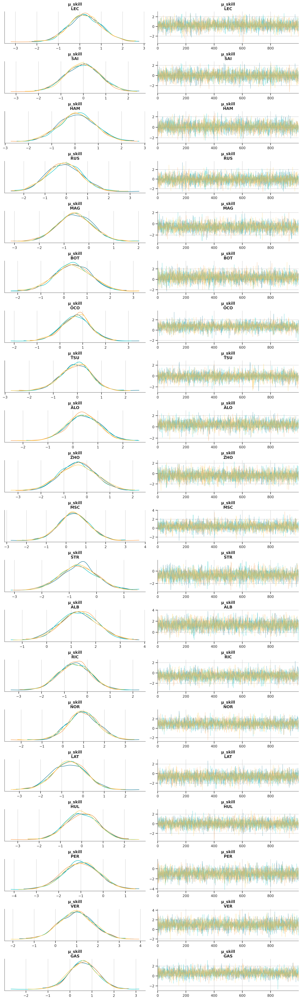

In [ ]:
# | label: fig-gp-teammate-h2h-circuit-driver-skill-trace
# | fig-cap: "Trace plots for driver skill for the circuit-enriched teammate head-to-head model."

az.plot_trace(
    gp_teammate_h2h_with_circuit_idata, var_names=["μ_skill"], compact=False
);

/home/kiril/.local/lib/python3.11/site-packages/arviz/plots/traceplot.py:222: UserWarning: rcParams['plot.max_subplots'] (20) is smaller than the number of variables to plot (52), generating only 20 plots
  warnings.warn(


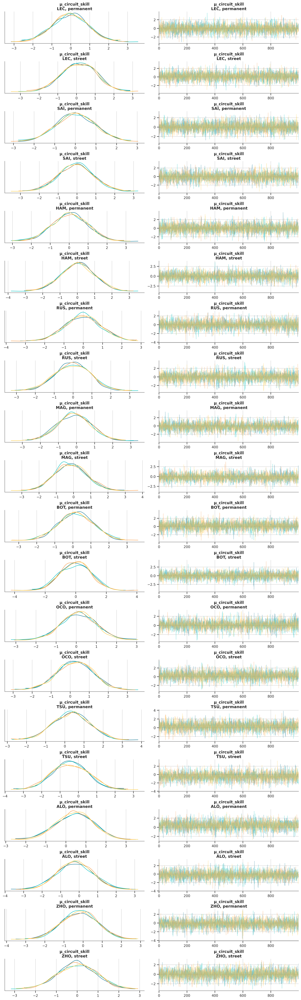

In [ ]:
# | label: fig-gp-teammate-h2h-circuit-circuit-skill-trace
# | fig-cap: "Trace plots for circuit skill for the circuit-enriched teammate head-to-head model."

az.plot_trace(
    gp_teammate_h2h_with_circuit_idata, var_names=["μ_circuit_skill"], compact=False
);

Next, we check the energy:

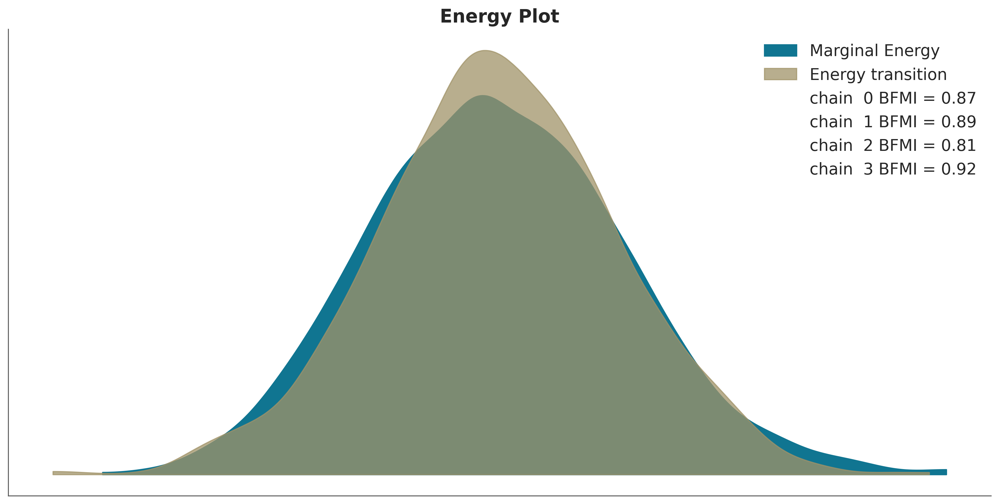

In [ ]:
# | label: fig-gp-teammate-h2h-circuit-energy
# | fig-cap: "Energy plot for the circuit-enriched teammate head-to-head model"

ax = az.plot_energy(gp_teammate_h2h_with_circuit_idata, figsize=(12, 6))
ax.set_title("Energy Plot");

## Full head-to-head

The previous two models have several issues:
- DNF results being included can unfairly penalize a driver's skill, since the causes are often not in their control. This leads to a skew, e.g. Perez is ranked highly on street circuits, but that is partially because Verstappen has experienced several reliablity issues specifically on street circuits.
- the skill rankings are limited to teammate against teammate - if a driver switches teams, we can't use the computed ranks to predict future performance.
- interpretation is difficult when a driver has had many teammates vs. only one.

We can fix a lot of this by going from teammate contests to viewing the whole race as a series of individual contests between all participating drivers. Each race classification - the ordering of drives, from first finisher to last - can be turned into pairs of head-to-head contests denoting which driver finished against which other driver. The winner, at p1, will generate 19 contest-pairs, as they've finished ahead of everyh other driver. P2 will generate 18, p3 - 17, and so on. We'll omit p20 finishers as by definition they don't finish ahead of anyone else; we'll also omit DNF results as they can obfucate true skill.

In [ ]:
#| code-fold: false

def h2h_row(df, row):
    losers = df[df["finishing_pos"] > row["finishing_pos"]][["driver", "constructor"]]
    return pd.Series(
        [row["driver"], row["constructor"], losers["driver"], losers["constructor"]],
        index=["winner", "winner_constructor", "loser", "loser_constructor"],
    )


def explode_h2h(df):
    return df.apply(lambda row: h2h_row(df, row), axis=1).explode(
        ["loser", "loser_constructor"]
    )


def to_h2h_df(df):
    drivers = pd.CategoricalDtype(df["driver"].unique())
    constructors = pd.CategoricalDtype(df["constructor"].unique())

    return (
        df.pipe(lambda df: df[df["status"].isin(["Finished", "+1 Lap", "+2 Lap"])])
        .groupby(["season", "circuit"])
        .apply(explode_h2h)
        .reset_index()
        .drop("level_2", axis=1)
        .dropna(how="any")
        .astype(
            {
                "winner": drivers,
                "loser": drivers,
                "winner_constructor": constructors,
                "loser_constructor": constructors,
            }
        )
    )

In [ ]:
# code-fold: true
gp_h2h_df = to_h2h_df(seasons_data_df)
show(gp_h2h_df, pageLength=25)

In [ ]:
winners_idx = gp_h2h_df["winner"].cat.codes
losers_idx = gp_h2h_df["loser"].cat.codes
observed = np.ones(winners_idx.shape[0])

### Model definition

Model definition is identical - we've simply switched the dataset:

In [ ]:
with pm.Model(coords={"driver": drivers}) as gp_h2h_base:
    σ_skill = pm.HalfNormal("σ_skill", sigma=1)
    μ_skill = pm.Normal("μ_skill", mu=0, sigma=1, dims="driver")
    skill = pm.Deterministic("skill", μ_skill * σ_skill, dims="driver")

    Δ = skill[winners_idx] - skill[losers_idx]

    y = pm.Bernoulli("y", logit_p=Δ, observed=observed)

### Prior predictive checks

Prior predictive looks reasonable, more or less like before:

In [ ]:
with gp_h2h_base:
    gp_h2h_prior_idata = pm.sample_prior_predictive()

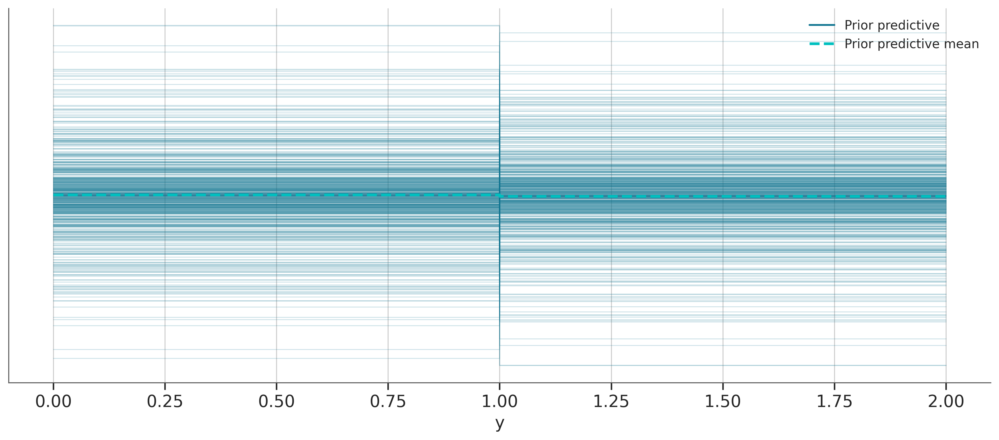

In [ ]:
az.plot_ppc(gp_h2h_prior_idata, group="prior", observed=False);

### Inference and diagnostics

This time, sampling produces a warning about effective sample size:

In [ ]:
with gp_h2h_base:
    gp_h2h_idata = pm.sample(
        target_accept=0.9, idata_kwargs={"log_likelihood": True}
    )
    pm.sample_posterior_predictive(gp_h2h_idata, extend_inferencedata=True)

ERROR:pymc.stats.convergence:The effective sample size per chain is smaller than 100 for some parameters.  A higher number is needed for reliable rhat and ess computation. See https://arxiv.org/abs/1903.08008 for details


We can inspect ESS by parameter directly from the inference data:

In [ ]:
az.summary(gp_h2h_idata, var_names=["μ_skill"])

,mean,sd,hdi_3%,hdi_97%,mcse_mean,mcse_sd,ess_bulk,ess_tail,r_hat
μ_skill[LEC],1.415,0.275,0.904,1.933,0.007,0.005,1562.0,2926.0,1.0
μ_skill[SAI],1.232,0.261,0.738,1.718,0.007,0.005,1538.0,2776.0,1.0
μ_skill[HAM],1.106,0.249,0.657,1.590,0.006,0.005,1517.0,2799.0,1.0
μ_skill[RUS],1.111,0.251,0.652,1.588,0.006,0.005,1517.0,2765.0,1.0
μ_skill[MAG],-0.901,0.233,-1.364,-0.483,0.006,0.004,1456.0,2690.0,1.0
μ_skill[BOT],-0.588,0.215,-0.988,-0.173,0.006,0.004,1422.0,2600.0,1.0
μ_skill[OCO],0.097,0.203,-0.296,0.463,0.005,0.004,1407.0,2622.0,1.0
μ_skill[TSU],-0.652,0.219,-1.069,-0.243,0.006,0.004,1451.0,2663.0,1.0
μ_skill[ALO],0.646,0.221,0.229,1.051,0.006,0.004,1472.0,2697.0,1.0
μ_skill[ZHO],-0.831,0.228,-1.251,-0.388,0.006,0.004,1458.0,2517.0,1.0


`ess_bulk` is below 400 in most cases, with `r_hat` at or above 1.01 in several; this indicates poor mixing, which is usually resolved through reparameterization and adjusting the sampler parameters. Given that the model is already non-centered (which is the most common reparameterization trick for solving this problem), and `target_accept` is at .9 already, it seems reasonable to try and bump up the number of draws:

In [ ]:
with gp_h2h_base:
    gp_h2h_idata = pm.sample(
        target_accept=0.9, idata_kwargs={"log_likelihood": True}, draws=4000
    )
    pm.sample_posterior_predictive(gp_h2h_idata, extend_inferencedata=True)

This time we see no warnings. The traceplots look more or less reasonable as well:

/home/kiril/.local/lib/python3.11/site-packages/arviz/plots/traceplot.py:222: UserWarning: rcParams['plot.max_subplots'] (20) is smaller than the number of variables to plot (26), generating only 20 plots
  warnings.warn(


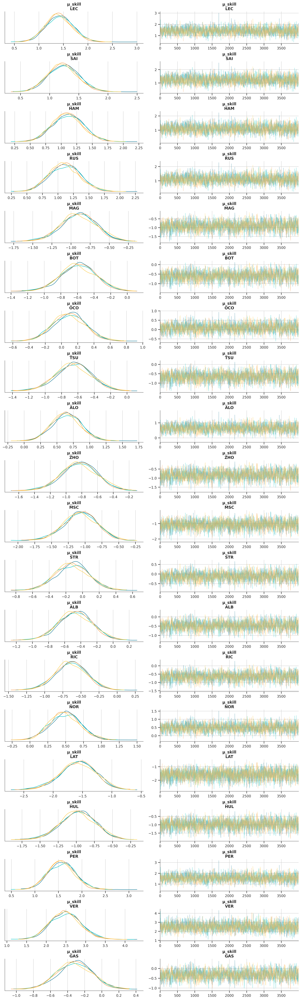

In [ ]:
az.plot_trace(gp_h2h_idata, var_names=["μ_skill"], compact=False);

The energy plot appears acceptable:

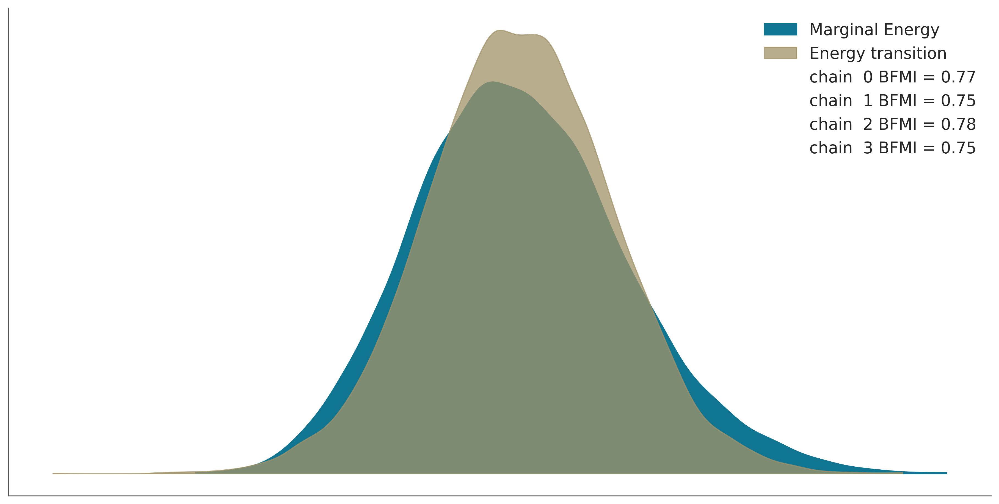

In [ ]:
az.plot_energy(gp_h2h_idata, figsize=(12, 6));

And finally, `ess_bulk` is sufficiently large, wit hall `r_hat` values at 1.

In [ ]:
az.summary(gp_h2h_idata, var_names=["μ_skill"])

,mean,sd,hdi_3%,hdi_97%,mcse_mean,mcse_sd,ess_bulk,ess_tail,r_hat
μ_skill[LEC],1.415,0.275,0.904,1.933,0.007,0.005,1562.0,2926.0,1.0
μ_skill[SAI],1.232,0.261,0.738,1.718,0.007,0.005,1538.0,2776.0,1.0
μ_skill[HAM],1.106,0.249,0.657,1.590,0.006,0.005,1517.0,2799.0,1.0
μ_skill[RUS],1.111,0.251,0.652,1.588,0.006,0.005,1517.0,2765.0,1.0
μ_skill[MAG],-0.901,0.233,-1.364,-0.483,0.006,0.004,1456.0,2690.0,1.0
μ_skill[BOT],-0.588,0.215,-0.988,-0.173,0.006,0.004,1422.0,2600.0,1.0
μ_skill[OCO],0.097,0.203,-0.296,0.463,0.005,0.004,1407.0,2622.0,1.0
μ_skill[TSU],-0.652,0.219,-1.069,-0.243,0.006,0.004,1451.0,2663.0,1.0
μ_skill[ALO],0.646,0.221,0.229,1.051,0.006,0.004,1472.0,2697.0,1.0
μ_skill[ZHO],-0.831,0.228,-1.251,-0.388,0.006,0.004,1458.0,2517.0,1.0


### Posterior predictive checks

The posterior predictive shows very strong separation, which I'm not entirely sure how to interpret, but likely expected given that Formula 1 has had a fairly consistent finishing order over the last few years:

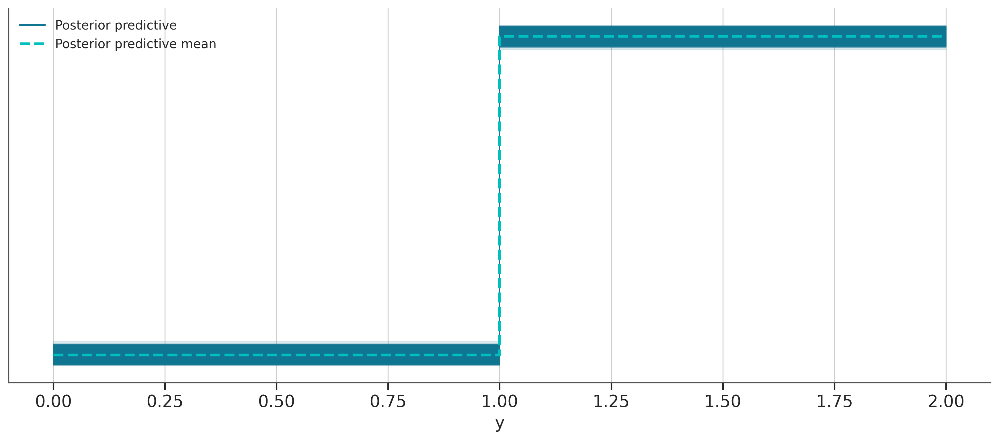

In [ ]:
az.plot_ppc(gp_h2h_idata, observed=False);

### Posterior evaluation

Finally, we look at the inferred skill rankings:

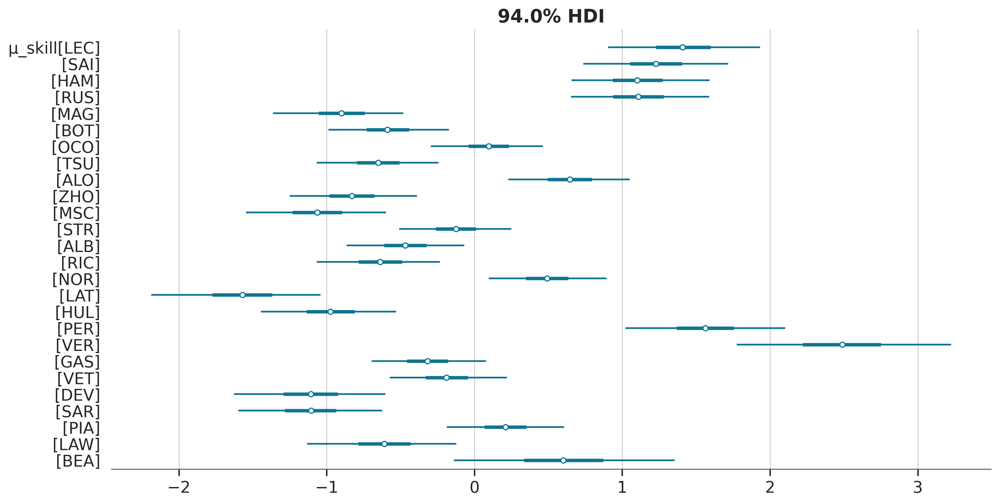

In [ ]:
az.plot_forest(gp_h2h_idata, var_names=["μ_skill"], combined=True, figsize=(12, 6));

This time we *can* interpret the inferred skill as the likelihood the given driver will finish ahead of any other competitor, not just their teammate. Zero acts as a neutral point again, with lower values being worse (hence all the usual backmarkers), and higher values being best (Verstappen & Red Bull's form clearly ahead of the competition being captured clearly, though less so for Perez).

Note that these rankings still don't give us a way to generate likely finishing position, just the head to head result of a driver finishing ahead of another driver. Furthermore, the skill factor itself is a combination of driver skill and car performance, so we can't see these as pure driver ability. Finally, since we dropped DNF results, this model does not take reliability into account and likely overestimates the rating for Alpine and Haas.

## Head-to-head with track type

We can include a track factor just like in the teammate vs teammate model and see if that helps with predictive performance.

In [ ]:
# | code-fold: false

gp_h2h_df = gp_h2h_df.merge(circuit_type_df, on="circuit");

circuit_type_idx, circuit_types = pd.factorize(
    gp_h2h_df["circuit_type"], sort=True
)

### Model definition

In [ ]:
with pm.Model(coords={"driver": drivers, "circuit_type": circuit_types}) as gp_h2h_circuit:
    σ_skill = pm.HalfNormal("σ_skill", sigma=1)
    μ_skill = pm.Normal("μ_skill", mu=0, sigma=1, dims="driver")
    skill = pm.Deterministic("skill", μ_skill * σ_skill, dims="driver")
    Δ_skill = skill[winners_idx] - skill[losers_idx]

    σ_circuit = pm.HalfNormal("σ_circuit", sigma=1)
    μ_circuit = pm.Normal("μ_circuit", mu=0, sigma=1, dims=("driver", "circuit_type"))
    circuit = pm.Deterministic("circuit", μ_circuit * σ_circuit)
    Δ_circuit = (circuit[winners_idx, circuit_type_idx] - circuit[losers_idx, circuit_type_idx])

    Δ = Δ_skill + Δ_circuit

    y = pm.Bernoulli("y", logit_p=Δ, observed=observed)

### Prior predictive checks

In [ ]:
with gp_h2h_circuit:
    gp_h2h_circuit_prior_idata = pm.sample_prior_predictive()

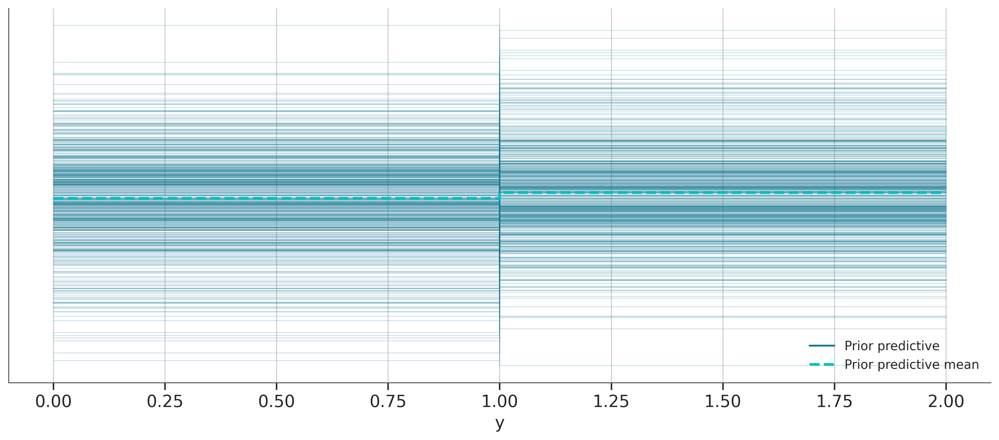

In [ ]:
az.plot_ppc(gp_h2h_circuit_prior_idata, group="prior");

### Inference and diagnostics

In [ ]:
with gp_h2h_circuit:
    gp_h2h_circuit_idata = pm.sample(
        target_accept=0.9, idata_kwargs={"log_likelihood": True}, draws=4000
    )
    pm.sample_posterior_predictive(gp_h2h_circuit_idata, extend_inferencedata=True)

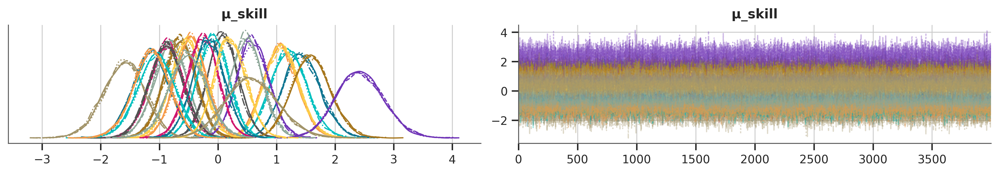

In [ ]:
az.plot_trace(gp_h2h_circuit_idata, var_names=["μ_skill"]);

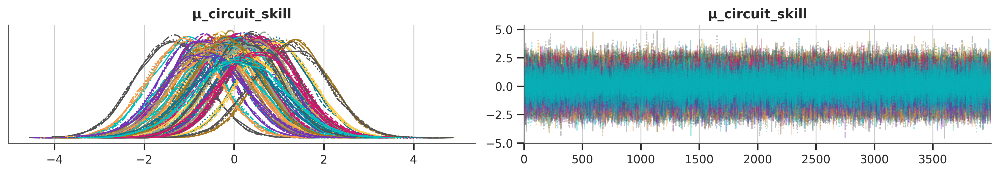

In [ ]:
az.plot_trace(gp_h2h_circuit_idata, var_names=["μ_circuit_skill"]);

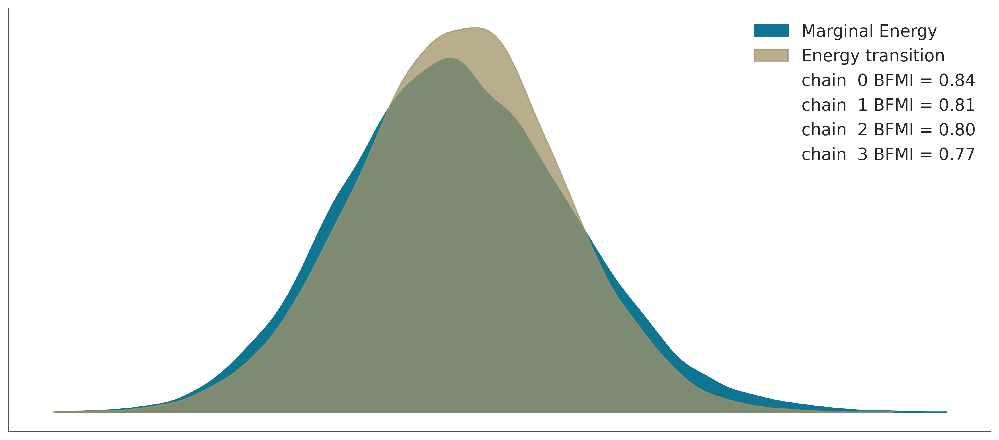

In [ ]:
az.plot_energy(gp_h2h_circuit_idata);

In [ ]:
az.summary(gp_h2h_circuit_idata, var_names=["μ_skill", "μ_circuit_skill"])

,mean,sd,hdi_3%,hdi_97%,mcse_mean,mcse_sd,ess_bulk,ess_tail,r_hat
μ_skill[LEC],1.438,0.322,0.839,2.044,0.004,0.003,6651.0,8982.0,1.0
μ_skill[SAI],1.215,0.306,0.643,1.792,0.004,0.003,6505.0,8913.0,1.0
μ_skill[HAM],1.074,0.296,0.524,1.634,0.004,0.003,6373.0,8938.0,1.0
μ_skill[RUS],1.090,0.295,0.530,1.634,0.004,0.003,6390.0,9397.0,1.0
μ_skill[MAG],-0.813,0.287,-1.338,-0.252,0.004,0.003,6518.0,9384.0,1.0
...,...,...,...,...,...,...,...,...,...
"μ_circuit_skill[PIA, street]",-0.169,0.785,-1.611,1.345,0.005,0.006,22115.0,13237.0,1.0
"μ_circuit_skill[LAW, permanent]",-0.660,0.908,-2.413,1.005,0.006,0.006,25720.0,12964.0,1.0
"μ_circuit_skill[LAW, street]",0.527,0.908,-1.200,2.202,0.006,0.006,25434.0,12053.0,1.0
"μ_circuit_skill[BEA, permanent]",0.001,0.992,-1.887,1.817,0.006,0.009,26949.0,11679.0,1.0


### Posterior predictive checks

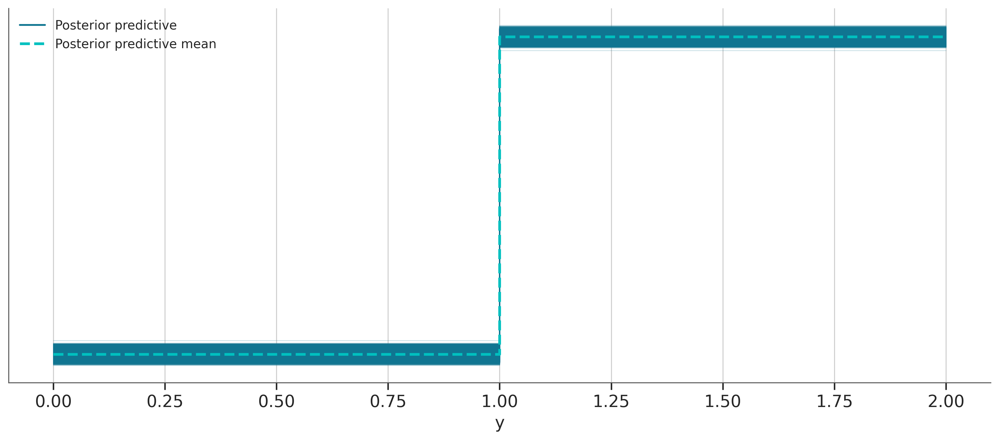

In [ ]:
az.plot_ppc(gp_h2h_circuit_idata, observed=False);

### Posterior evaluation

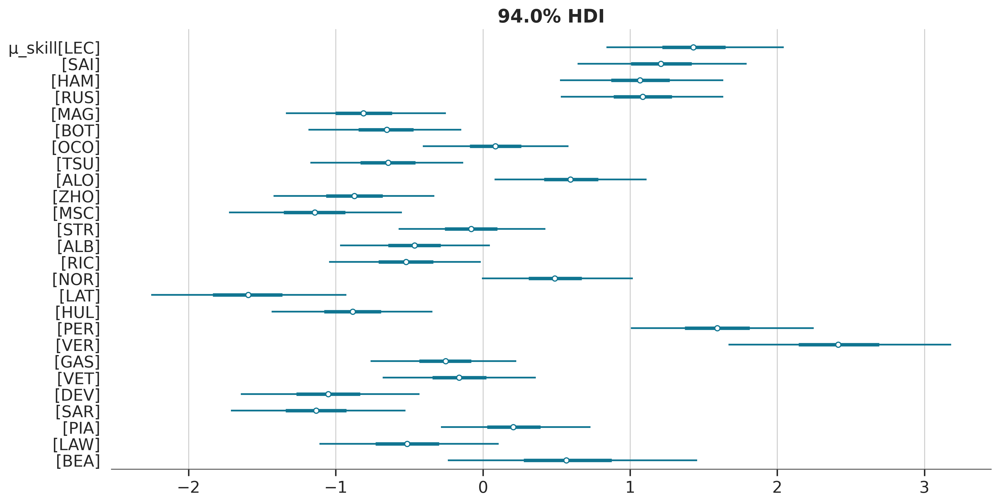

In [ ]:
az.plot_forest(gp_h2h_circuit_idata, var_names=["μ_skill"], combined=True,  figsize=(12, 6));

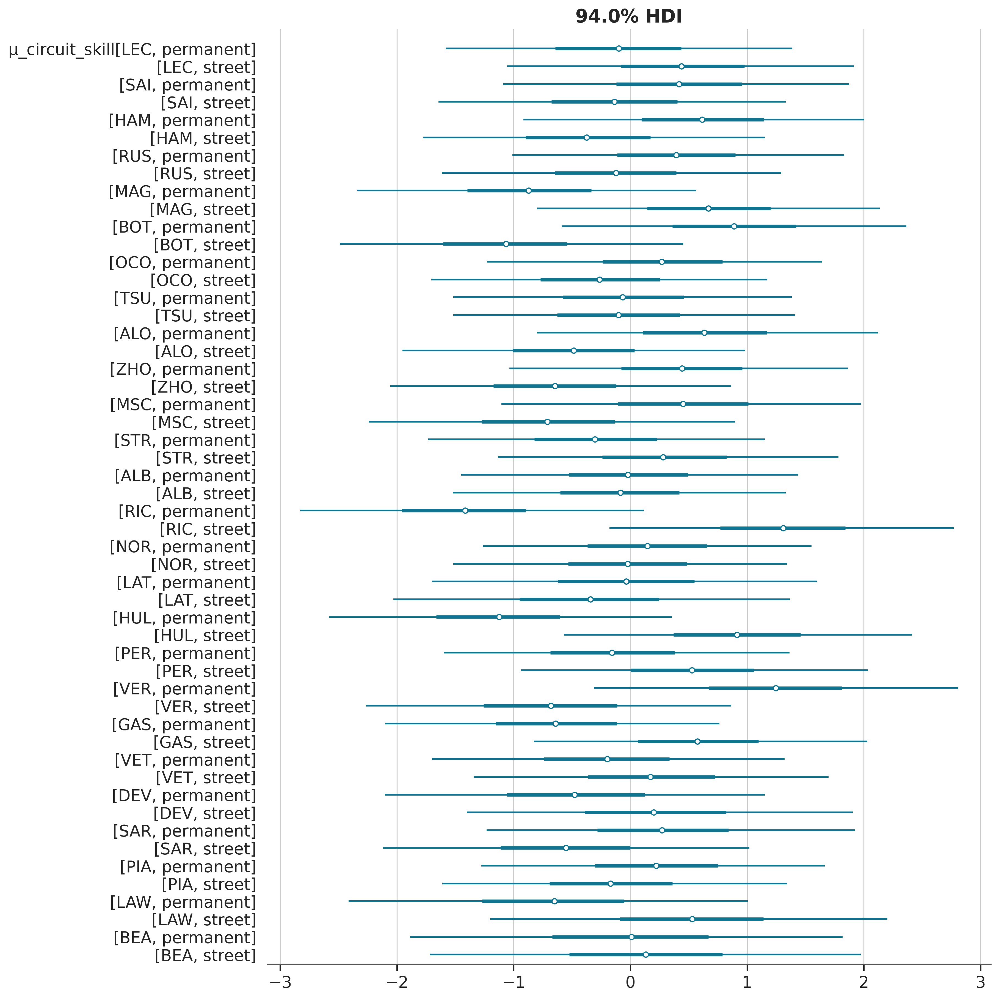

In [ ]:
az.plot_forest(gp_h2h_circuit_idata, var_names=["μ_circuit_skill"], combined=True,  figsize=(12, 12));

### Model comparison

In [ ]:
az.compare({"base": gp_h2h_idata, "with track": gp_h2h_circuit_idata})

,rank,elpd_loo,p_loo,elpd_diff,weight,se,dse,warning,scale
with track,0,-2364.918621,42.550925,0.000000,0.972204,42.915195,0.00000,False,log
base,1,-2395.240805,24.566528,30.322184,0.027796,42.876131,8.05865,False,log


## Head-to-head with constructor

In [ ]:
constructors = gp_h2h_df["winner_constructor"].dtype.categories

In [ ]:
winner_constructor_idx = gp_h2h_df["winner_constructor"].cat.codes
loser_constructor_idx = gp_h2h_df["loser_constructor"].cat.codes

In [ ]:
with pm.Model(
    coords={"driver": drivers, "constructor": constructors}
) as gp_h2h_car:
    σ_skill = pm.HalfNormal("σ_skill", sigma=1)
    μ_skill = pm.Normal("μ_skill", mu=0, sigma=1, dims="driver")
    skill = pm.Deterministic("skill", μ_skill * σ_skill, dims="driver")
    Δ_skill = skill[winners_idx] - skill[losers_idx]

    σ_car = pm.HalfNormal("σ_car", sigma=1)
    μ_car = pm.Normal("μ_car", mu=0, sigma=1, dims="constructor")
    car = pm.Deterministic("car", μ_car * σ_car)
    Δ_car = (car[winner_constructor_idx] - car[loser_constructor_idx])

    Δ = Δ_skill + Δ_car

    y = pm.Bernoulli(
        "y", logit_p=Δ, observed=np.ones(winners_idx.shape[0])
    )

In [ ]:
with gp_h2h_car:
    gp_h2h_car_prior_idata = pm.sample_prior_predictive()

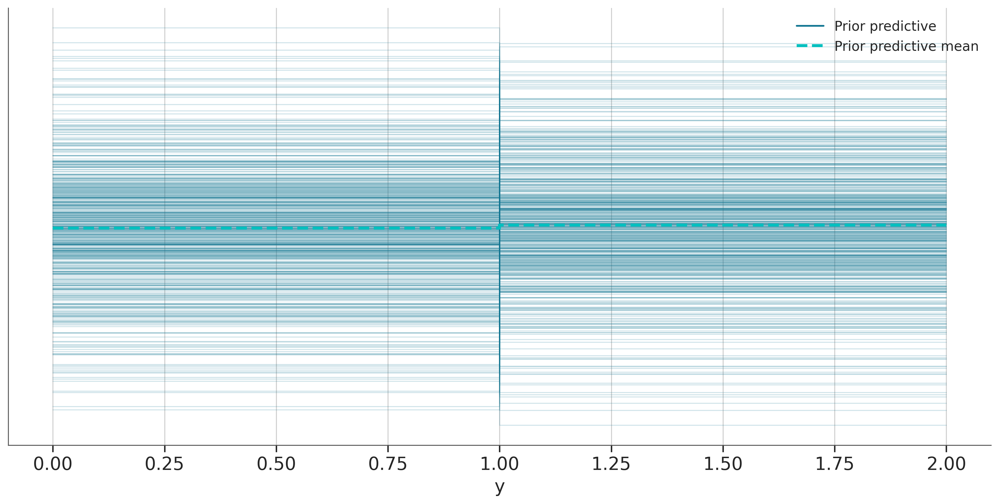

In [ ]:
az.plot_ppc(
    gp_h2h_car_prior_idata, group="prior", observed=False, figsize=(12, 6)
);

In [ ]:
with gp_h2h_car:
    gp_h2h_car_idata = pm.sample(
        target_accept=0.9, idata_kwargs={"log_likelihood": True}, draws=4000
    )
    pm.sample_posterior_predictive(gp_h2h_car_idata, extend_inferencedata=True)

In [ ]:
az.summary(gp_h2h_car_idata, var_names=["μ_skill", "μ_constructor_skill"])

,mean,sd,hdi_3%,hdi_97%,mcse_mean,mcse_sd,ess_bulk,ess_tail,r_hat
μ_skill[LEC],0.747,0.539,-0.247,1.771,0.005,0.004,12496.0,11926.0,1.0
μ_skill[SAI],0.508,0.540,-0.479,1.551,0.005,0.004,11804.0,11907.0,1.0
μ_skill[HAM],0.474,0.608,-0.673,1.601,0.005,0.004,13785.0,11412.0,1.0
μ_skill[RUS],0.478,0.607,-0.675,1.586,0.005,0.004,13409.0,11489.0,1.0
μ_skill[MAG],-1.486,0.395,-2.216,-0.735,0.004,0.003,11327.0,11209.0,1.0
μ_skill[BOT],-0.173,0.596,-1.313,0.931,0.005,0.005,15595.0,10560.0,1.0
μ_skill[OCO],0.819,0.339,0.194,1.458,0.005,0.003,4856.0,7909.0,1.0
μ_skill[TSU],0.323,0.301,-0.238,0.879,0.004,0.003,5517.0,8658.0,1.0
μ_skill[ALO],1.109,0.376,0.393,1.804,0.006,0.004,4558.0,7581.0,1.0
μ_skill[ZHO],-0.496,0.593,-1.633,0.600,0.005,0.004,16008.0,10445.0,1.0


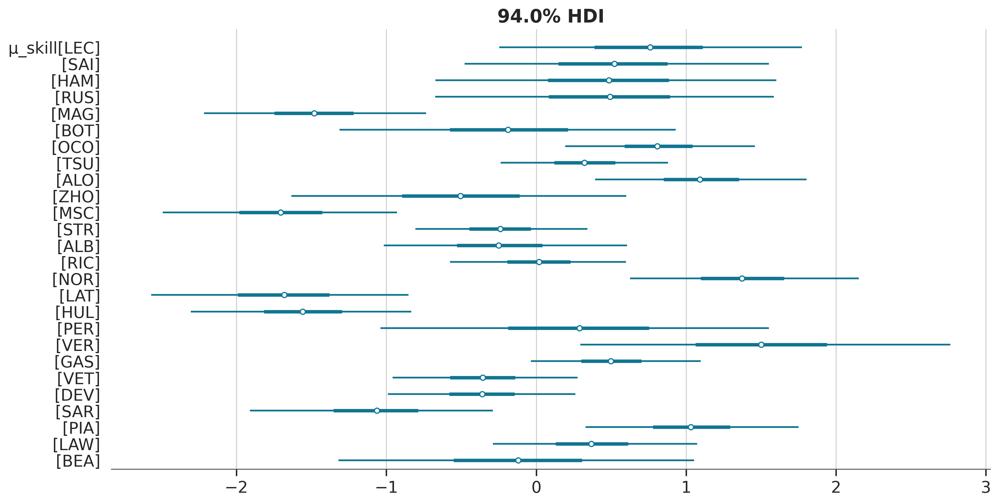

In [ ]:
az.plot_forest(
    gp_h2h_car_idata,
    var_names=["μ_skill"],
    combined=True,
    figsize=(12, 6),
);

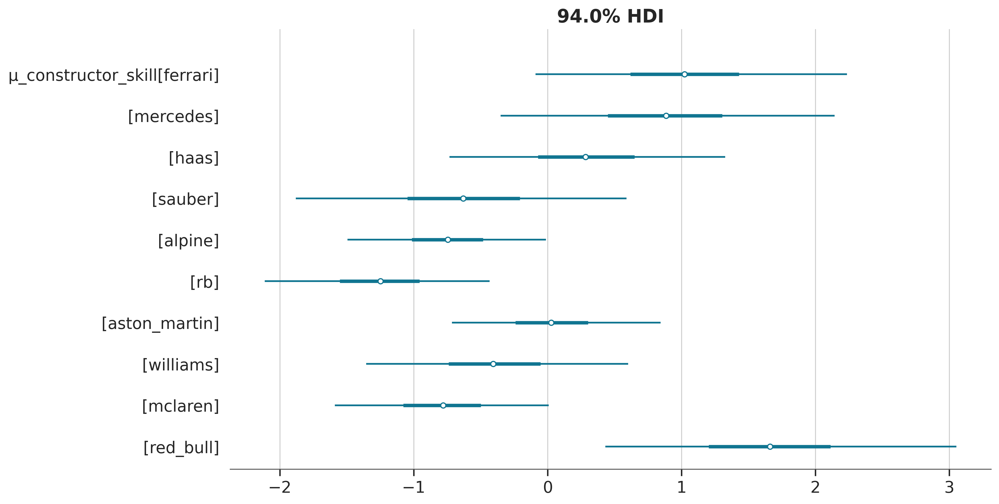

In [ ]:
az.plot_forest(
    gp_h2h_car_idata,
    var_names=["μ_car"],
    combined=True,
    figsize=(12, 6),
);

In [ ]:
az.compare({"base": gp_h2h_idata, "with track": gp_h2h_circuit_idata, "with car": gp_h2h_car_idata})

,rank,elpd_loo,p_loo,elpd_diff,weight,se,dse,warning,scale
with track,0,-2364.918621,42.550925,0.000000,5.739782e-01,42.915195,0.000000,False,log
with car,1,-2372.897301,28.338661,7.978681,4.260218e-01,42.858317,10.510026,False,log
base,2,-2395.240805,24.566528,30.322184,3.548051e-12,42.876131,8.058650,False,log


## Head-to-head all features

In [ ]:
with pm.Model(
    coords={"driver": drivers, "constructor": constructors, "circuit_type": circuit_types}
) as gp_h2h_all:
    σ_skill = pm.HalfNormal("σ_skill", sigma=1)
    μ_skill = pm.Normal("μ_skill", mu=0, sigma=1, dims="driver")
    skill = pm.Deterministic("skill", μ_skill * σ_skill, dims="driver")
    Δ_skill = skill[winners_idx] - skill[losers_idx]

    σ_car = pm.HalfNormal("σ_car", sigma=1)
    μ_car = pm.Normal("μ_car", mu=0, sigma=1, dims="constructor")
    car = pm.Deterministic("car", μ_car * σ_car)
    Δ_car = (car[winner_constructor_idx] - car[loser_constructor_idx])

    σ_circuit = pm.HalfNormal("σ_circuit", sigma=1)
    μ_circuit = pm.Normal("μ_circuit", mu=0, sigma=1, dims=("driver", "circuit_type"))
    circuit = pm.Deterministic("circuit", μ_circuit * σ_circuit)
    Δ_circuit = (circuit[winners_idx, circuit_type_idx] - circuit[losers_idx, circuit_type_idx])

    Δ = Δ_skill + Δ_car + Δ_circuit

    y = pm.Bernoulli("y", logit_p=Δ, observed=np.ones(winners_idx.shape[0]))

In [ ]:
with gp_h2h_all:
    gp_h2h_all_idata = pm.sample(
        target_accept=0.9, idata_kwargs={"log_likelihood": True}, draws=4000
    )
    pm.sample_posterior_predictive(gp_h2h_all_idata, extend_inferencedata=True)

In [ ]:
az.compare({"base": gp_h2h_idata, "with track": gp_h2h_circuit_idata, "with car": gp_h2h_car_idata, "all features": gp_h2h_all_idata})

,rank,elpd_loo,p_loo,elpd_diff,weight,se,dse,warning,scale
all features,0,-2338.511954,46.902050,0.000000,0.967577,42.849247,0.000000,False,log
with track,1,-2364.918621,42.550925,26.406667,0.000000,42.915195,6.824236,False,log
with car,2,-2372.897301,28.338661,34.385348,0.032423,42.858317,8.641817,False,log
base,3,-2395.240805,24.566528,56.728851,0.000000,42.876131,10.583248,False,log


## Reusable inputs

In [ ]:
with pm.Model(
    coords={"driver": drivers, "constructor": constructors, "circuit_type": circuit_types}
) as h2h:
    _winners_idx = pm.MutableData("winners_idx", winners_idx)
    _losers_idx = pm.MutableData("losers_idx", losers_idx)

    _winner_constructor_idx = pm.MutableData("winner_constructor_idx", winner_constructor_idx)
    _loser_constructor_idx = pm.MutableData("loser_constructor_idx", loser_constructor_idx)

    _circuit_type_idx = pm.MutableData("circuit_type_idx", circuit_type_idx)
    
    σ_skill = pm.HalfNormal("σ_skill", sigma=1)
    μ_skill = pm.Normal("μ_skill", mu=0, sigma=1, dims="driver")
    skill = pm.Deterministic("skill", μ_skill * σ_skill, dims="driver")
    Δ_skill = skill[_winners_idx] - skill[_losers_idx]

    σ_car = pm.HalfNormal("σ_car", sigma=1)
    μ_car = pm.Normal("μ_car", mu=0, sigma=1, dims="constructor")
    car = pm.Deterministic("car", μ_car * σ_car)
    Δ_car = (car[_winner_constructor_idx] - car[_loser_constructor_idx])

    σ_circuit = pm.HalfNormal("σ_circuit", sigma=1)
    μ_circuit = pm.Normal("μ_circuit", mu=0, sigma=1, dims=("driver", "circuit_type"))
    circuit = pm.Deterministic("circuit", μ_circuit * σ_circuit)
    Δ_circuit = (circuit[_winners_idx, _circuit_type_idx] - circuit[_losers_idx, _circuit_type_idx])

    Δ = Δ_skill + Δ_car + Δ_circuit

    y = pm.Bernoulli("y", logit_p=Δ, observed=np.ones(_winners_idx.shape[0]))

In [ ]:
gp_h2h_all_idata

Inference data with groups:
	> posterior
	> posterior_predictive
	> log_likelihood
	> sample_stats
	> observed_data

In [ ]:
#| echo: false
weights = (
    gp_h2h_df["season"]
    .replace({2022: 0.7, 2023: 0.8, 2023: 0.9, 2024: 1})
    .values
)

with pm.Model(
    coords={"driver": drivers.categories, "constructor": constructors.categories}
) as gp_h2h_weighted:
    driver_skill_sd = pm.HalfNormal("driver_skill_sd", sigma=1)
    driver_skill_mu = pm.Normal("driver_skill_mu", mu=0, sigma=1, dims="driver")
    driver_skill = pm.Deterministic("driver_skill", driver_skill_sd * driver_skill_mu)

    car_sd = pm.HalfNormal("car_advantage_sd", sigma=1)
    car_mu = pm.Normal("car_advantage_mu", mu=0, sigma=1, dims="constructor")
    car = pm.Deterministic("car_advantage", car_mu * car_sd)

    performance_delta = (
        driver_skill[winners_idx]
        + car[winner_car_idx]
        - driver_skill[losers_idx]
        - car[loser_car_idx]
    )

    y = pm.Potential(
        "y",
        weights
        * pm.logp(
            pm.Bernoulli.dist(logit_p=performance_delta),
            value=np.ones(winners_idx.shape[0]),
        ),
    )